In [1]:
import os

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "3"

In [2]:
import torch

import numpy as np
import scipy.io as sio
from torch.fft import fft2, ifft2, fftshift, ifftshift
import math
import os
from matplotlib import cm, colors

import matplotlib.pyplot as plt
import torch.optim as optim

cmap = cm.get_cmap("Spectral")

np.random.seed(0)
torch.manual_seed(0)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(torch.cuda.get_device_name())

rng = np.random.default_rng()

AssertionError: Torch not compiled with CUDA enabled

In [3]:
pi = math.pi
sq2 = math.sqrt(2.0)
sq22 = math.sqrt(2.0) / 2.0
phase_off = torch.tensor([0, 45, 90, 135], device=device)
phase_off = phase_off / 180.0 * pi
phase_off = torch.exp(1j * phase_off)


def v2m(v):
    # first dim is polarization
    # v is 4-x-y
    assert len(v.shape) == 3  # to be safe
    # v = v*phase_off[:,None,None]
    foo1 = (v[1] + v[3]) / sq2
    foo2 = (v[1] - v[3]) / sq2
    m1 = (v[0].real + foo2.real) / 2
    m2 = (v[2].imag + foo1.imag) / 2
    m3 = (v[0].imag + v[2].real + foo1.real + foo2.imag) / 4
    return torch.stack([m1, m2, m3])

In [ ]:
def bfft2(x):
    return fftshift(fft2(x), dim=(-2, -1))


def bifft2(x):
    return ifft2(ifftshift(x, dim=(-2, -1)))


def tv2d_iso_b(x):
    # batch-nz-nx-ny
    assert len(x.shape) == 3
    dx = x[:, 1:, :-1] - x[:, :-1, :-1]
    dy = x[:, :-1, 1:] - x[:, :-1, :-1]
    # dy = x[:,:-1,:-1,1:]-x[:,:-1,:-1,:-1]
    return torch.sqrt(torch.abs(dx) ** 2 + torch.abs(dy) ** 2 + 1e-7).mean()


def tv2d_iso(x):
    # batch-nz-nx-ny
    assert len(x.shape) == 2
    dx = x[1:, :-1] - x[:-1, :-1]
    dy = x[:-1, 1:] - x[:-1, :-1]
    # dy = x[:,:-1,:-1,1:]-x[:,:-1,:-1,:-1]
    return torch.sqrt(torch.abs(dx) ** 2 + torch.abs(dy) ** 2 + 1e-7).mean()


def mse_real(x1, x2):
    return ((x1 - x2).abs() ** 2).mean()


def mse_cpx(x1, x2):
    return ((x1 - x2) ** 2).mean()

In [4]:
"""
def forward_vfp(input,kxyt,P):
    mf = bfft2(input)
    #mf = input
    i_pred = []
    nled = kxyt.shape[0]
    for i in range(nled):
        i_pred.append(mf[:,kxyt[i,0]:kxyt[i,0]+nxl,\
            kxyt[i,1]:kxyt[i,1]+nxl])
    i_pred = torch.stack(i_pred)
    i_predx = i_pred[:,0,...]+1j*i_pred[:,2,...]
    i_predy = i_pred[:,2,...]+1j*i_pred[:,1,...]
    #print(i_pred.shape)
    i_pred = torch.stack([i_predx,i_predy])
    #print(i_pred.shape)
    i_pred = i_pred * P * CTF
    i_pred = bifft2(i_pred)
    i_0 = i_pred[0]
    i_45 = sq22*i_pred[0]+sq22*i_pred[1]
    i_90 = i_pred[1]
    i_145 = -sq22*i_pred[0]+sq22*i_pred[1]
    return torch.abs(torch.stack([i_0,i_45,i_90,i_145]))
"""


# return i_pred
def forward_fp(input, kxyt, P):
    mf = bfft2(input)
    # mf = input
    i_pred = []
    nled = kxyt.shape[0]
    for i in range(nled):
        i_pred.append(
            mf[:, kxyt[i, 0] : kxyt[i, 0] + nxl, kxyt[i, 1] : kxyt[i, 1] + nxl]
        )
    i_pred = torch.stack(i_pred)
    # print(i_pred.shape)
    i_pred = i_pred * P * CTF
    return torch.abs(bifft2(i_pred))


def forward_lcp(a, delta, ori, kxyt, P):
    # a is complex
    ### a is what? dimension?
    ### kxyt is the position of the LED
    ### P is the pupil function
    delta = delta / 2.0
    ori = ori * 2.0
    m1 = torch.cos(delta) + 1j * torch.sin(delta) * torch.cos(ori)
    ###  why multiply cos(ori)?
    m2 = torch.cos(delta) - 1j * torch.sin(delta) * torch.cos(ori)
    m3 = 1j * torch.sin(delta) * torch.sin(ori)
    [m1, m2, m3] = [a * x for x in [m1, m2, m3]]
    ### Measurement of 4 polarization
    a0 = m1 + 1j * m3
    a45 = sq22 * (m1 + 1j * m3) + sq22 * (m3 + 1j * m2)
    a90 = m3 + 1j * m2
    a145 = -sq22 * (m1 + 1j * m3) + sq22 * (m3 + 1j * m2)
    # return torch.stack([a0,a45,a90,a145])
    return forward_fp(torch.stack([a0, a45, a90, a145]), kxyt, P)

In [30]:
fn = sio.loadmat("./data/i%d.mat" % 135)

In [31]:
a_meas = []
O_init = []
for i in [0, 45, 90, 135]:
    fname = "./data/i%d.mat" % i
    print(fname)
    fn = sio.loadmat(fname)
    foo = torch.sqrt(torch.tensor(fn["I"], dtype=torch.float32))
    foo2 = torch.tensor(fn["O"], dtype=torch.complex64)
    ### what is O and a? is it phase and amplitude?
    a_meas.append(foo)
    O_init.append(foo2)
del foo
del foo2
a_meas = torch.stack(a_meas, dim=1)
kxy = torch.tensor(fn["Ns"], dtype=torch.int64)
# CTF = torch.tensor(fn['P'],dtype=torch.complex64)
O_init = torch.stack(O_init)
fn = sio.loadmat("./data/Pavg.mat")
### What is Pavg?? Shoud it be MTF instead of CTF?
P1 = torch.tensor(fn["P"], dtype=torch.complex64)
CTF = (P1.abs() > 0).to(torch.float32)
nx = 1000
nxl = 200
cen0 = 501
kxy = kxy - math.floor(nxl / 2) + cen0 - 1

# m = (1e-5*torch.randn(3,nx,nx,dtype=torch.complex64)).detach().to(device)
a4 = bifft2(O_init.to(device))
a = a4.mean(dim=0)
### What is V1 and V2??
v1 = (a4[2] - a4[0]) / (a4[2] + a4[0] + 0.01)
v2 = (a4[1] - a4[3]) / (a4[1] + a4[3] + 0.01)
delta = torch.arcsin(torch.sqrt(v1**2 + v2**2)).real
ori = 0.5 * torch.arctan(v1 / (v2 + 1e-5)).real
[a, delta, ori] = [foo.detach().requires_grad_(True) for foo in [a, delta, ori]]
# a.requires_grad_(True)
P = P1.unsqueeze(0).unsqueeze(0).to(device)
P.requires_grad_(True)
CTF = CTF.to(device).unsqueeze(0).unsqueeze(0)
print(a.shape, P.shape, CTF.shape)
print(a.dtype, delta.dtype, ori.dtype)

./data/i0.mat
./data/i45.mat
./data/i90.mat
./data/i135.mat
torch.Size([1000, 1000]) torch.Size([1, 1, 200, 200]) torch.Size([1, 1, 200, 200])
torch.complex64 torch.float32 torch.float32


In [32]:
ipred = forward_lcp(a, delta, ori, kxy, P)
ipred.shape

torch.Size([169, 4, 200, 200])

In [33]:
stepSize_nes = 1e-4
stepSize = 5e-2
P_init = P.detach()
tv_reg_param = 1e-2
# optmizer = optim.SGD([m], lr=stepSize_nes,momentum=0.85,nesterov=True)
optmizer = optim.Adam(
    [a, delta, ori], lr=stepSize, betas=(0.85, 0.95), eps=1e-5, amsgrad=False
)
loss_tot = []
niter = 2000
batch_led = 128
nled = kxy.shape[0]
i_iter = 0

99


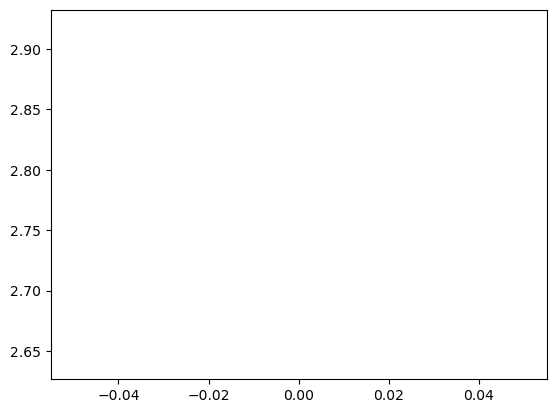

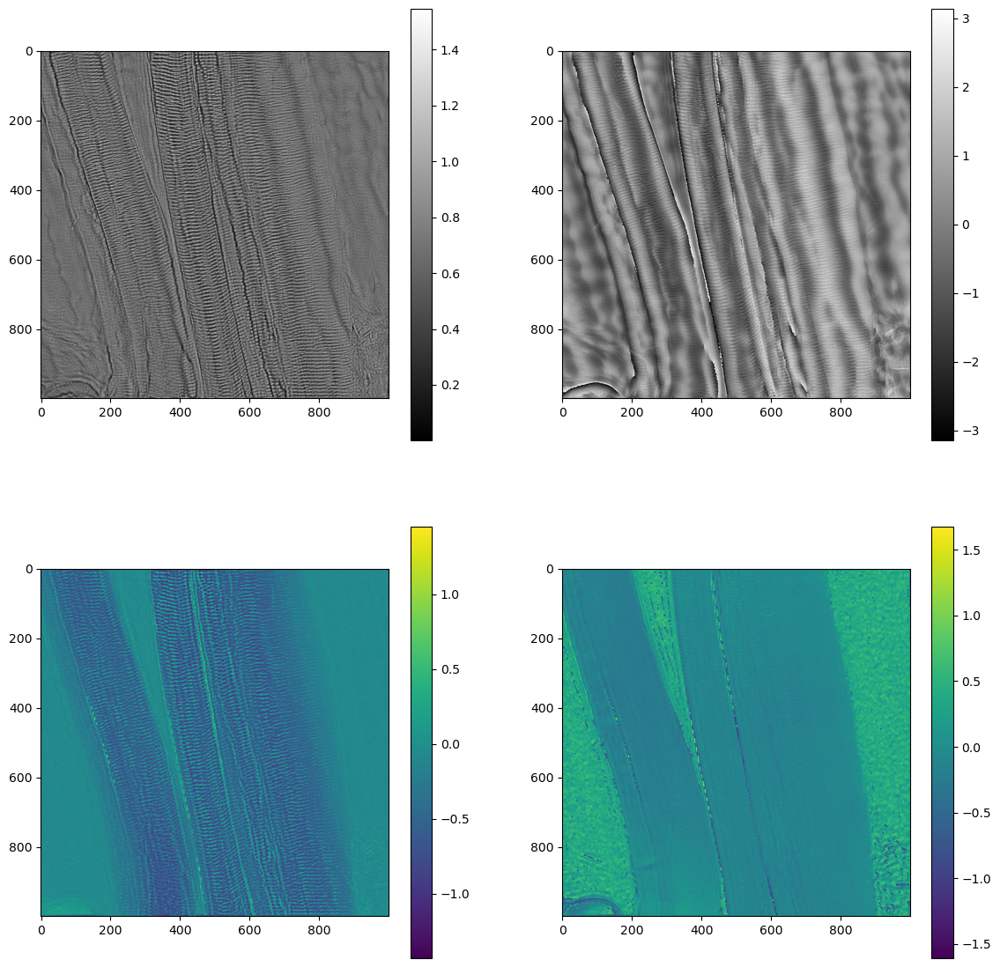

199


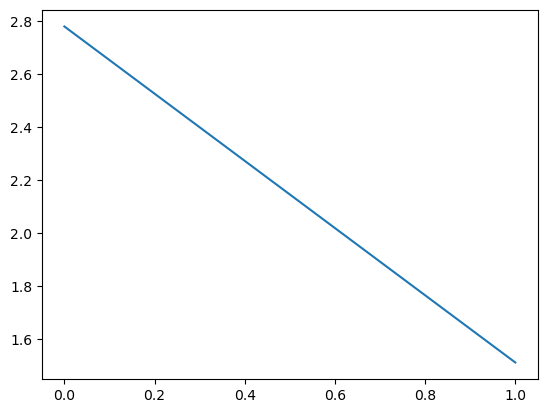

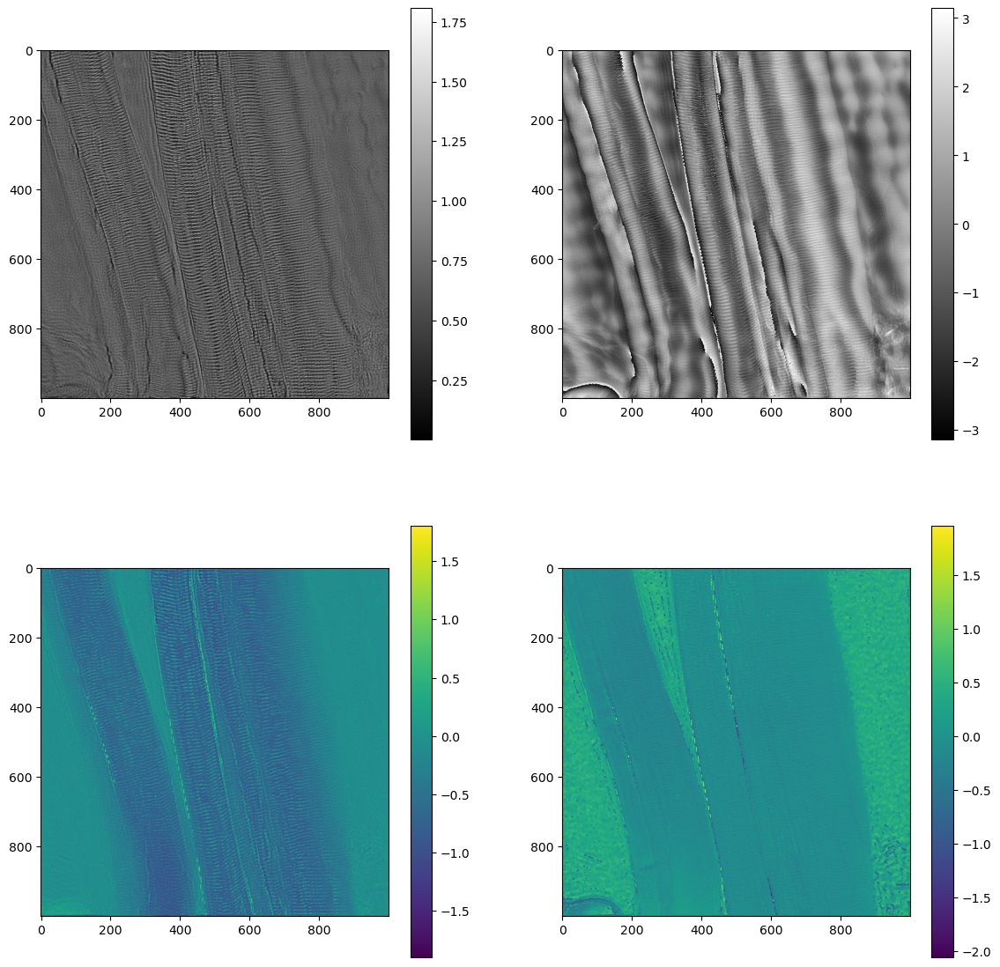

299


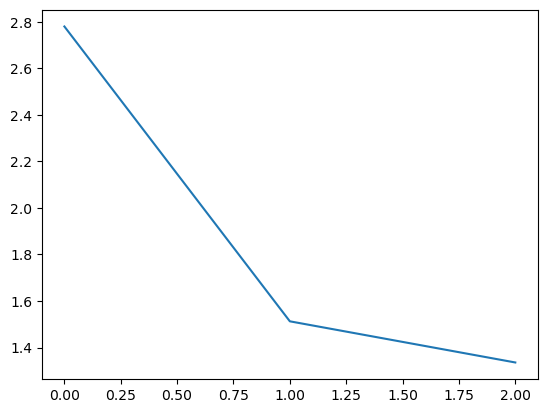

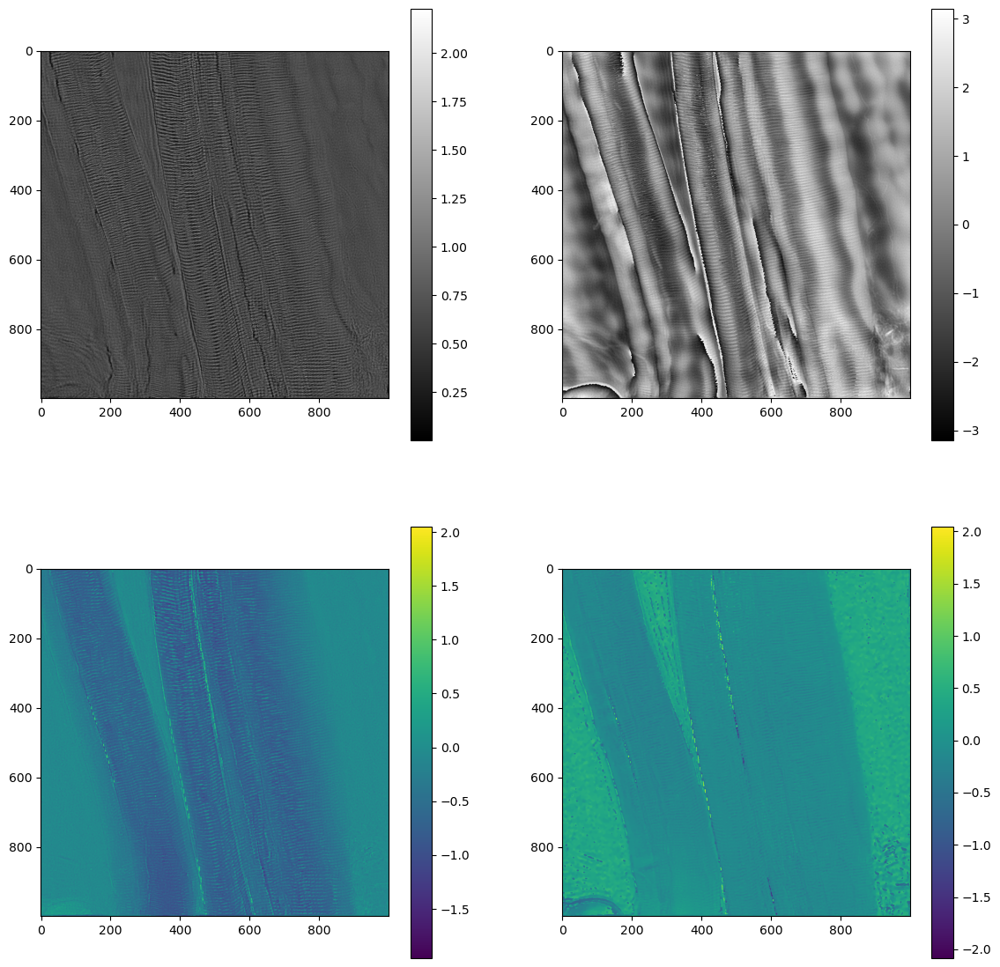

399


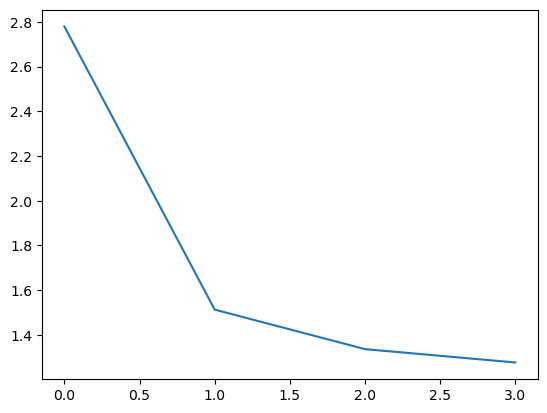

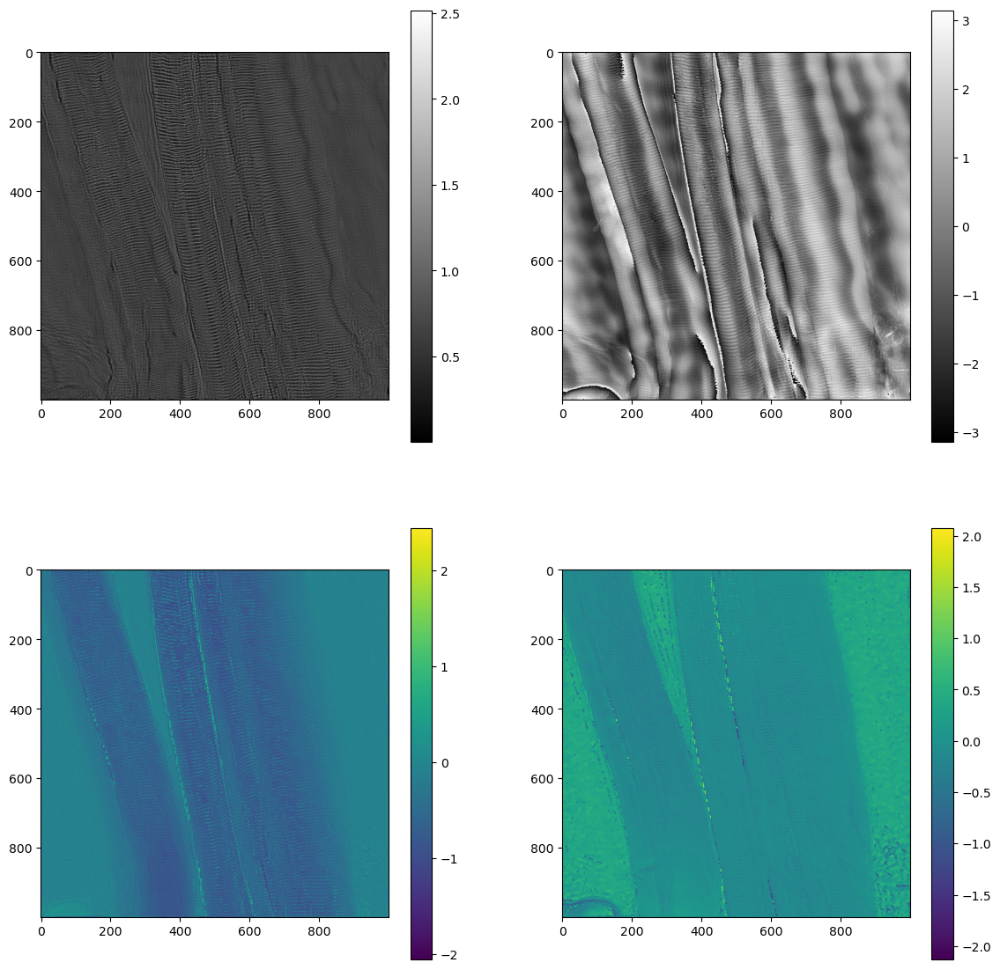

499


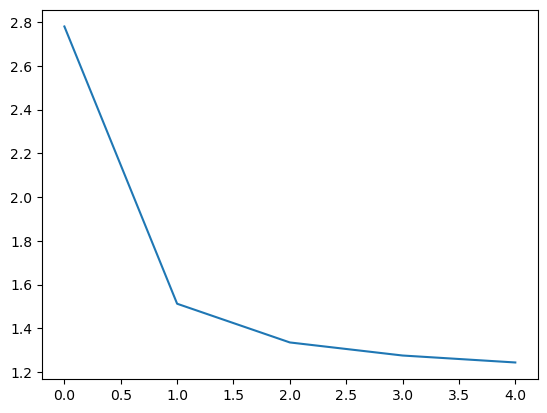

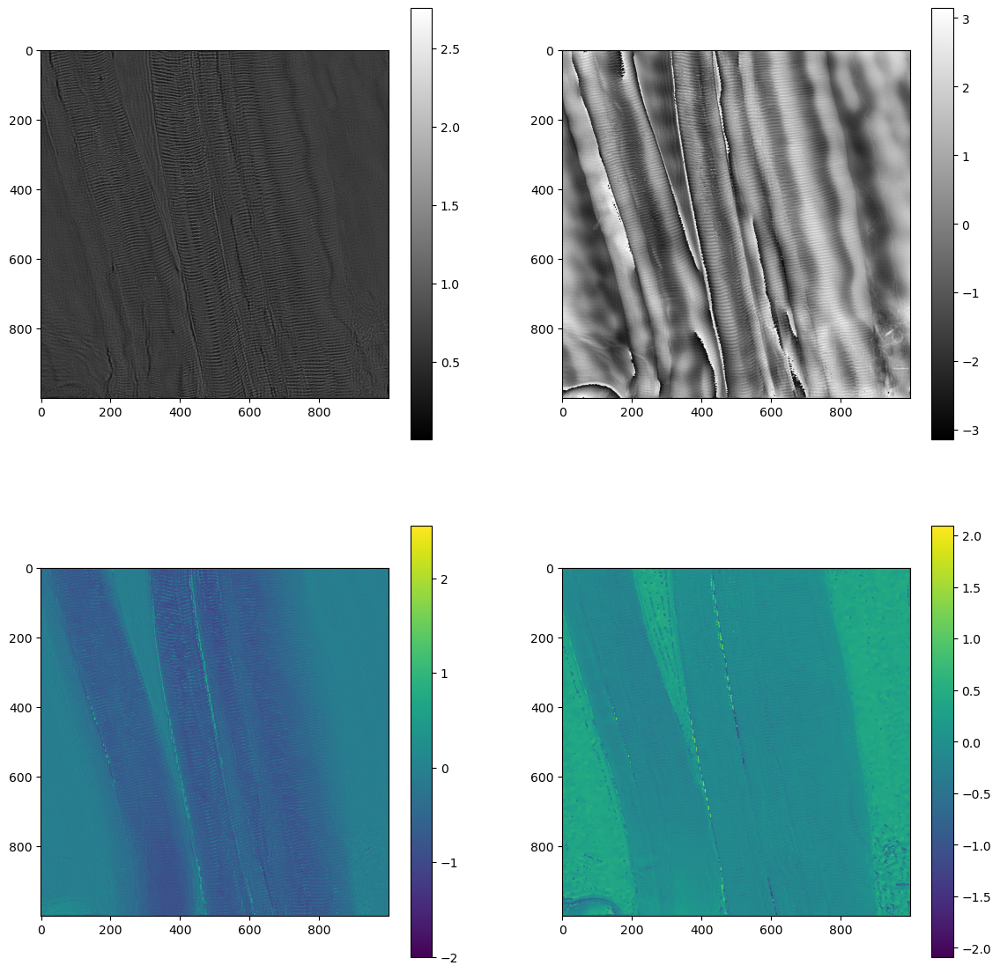

599


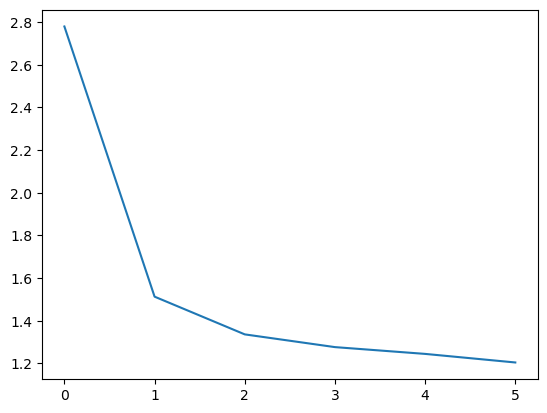

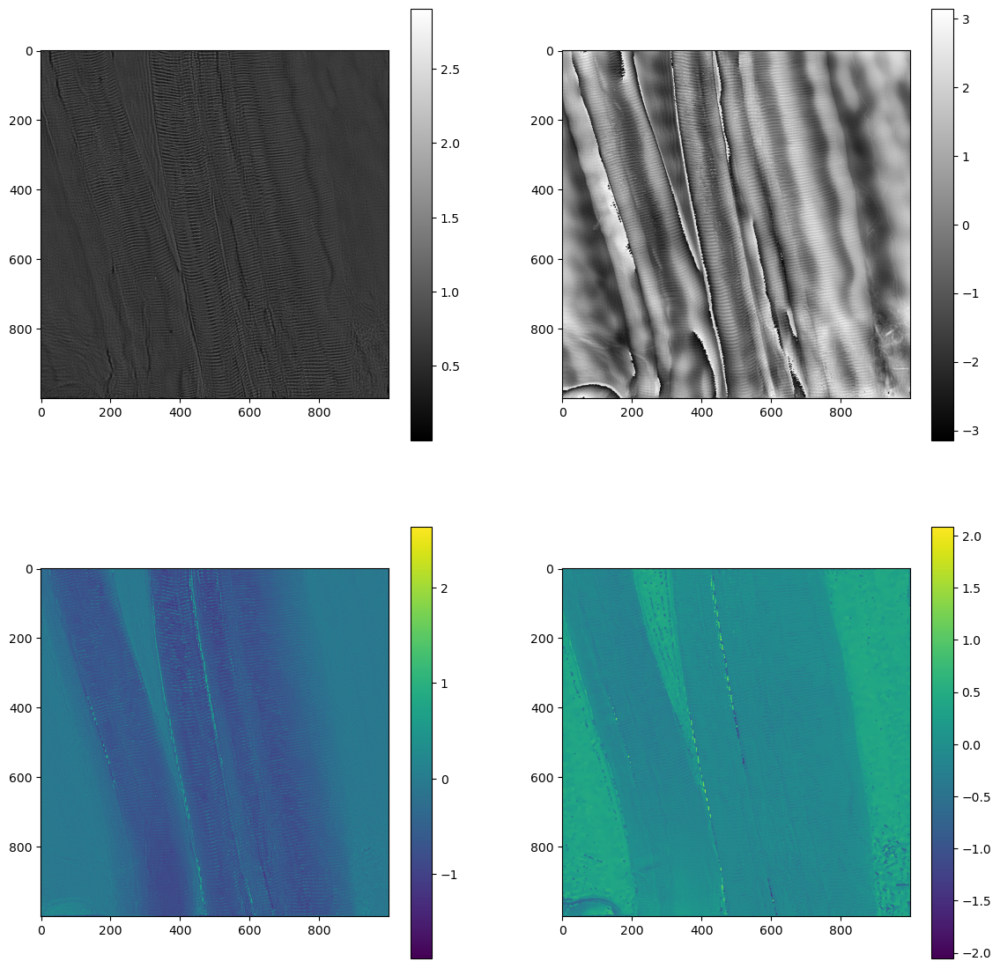

699


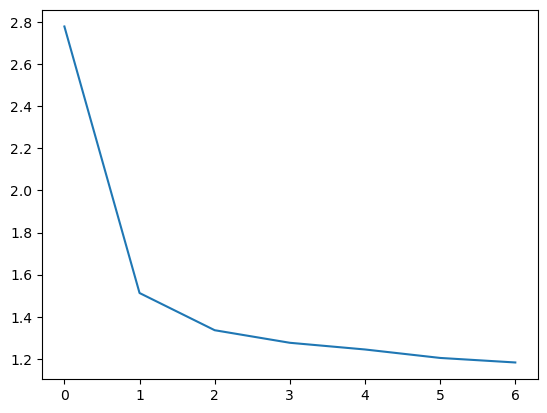

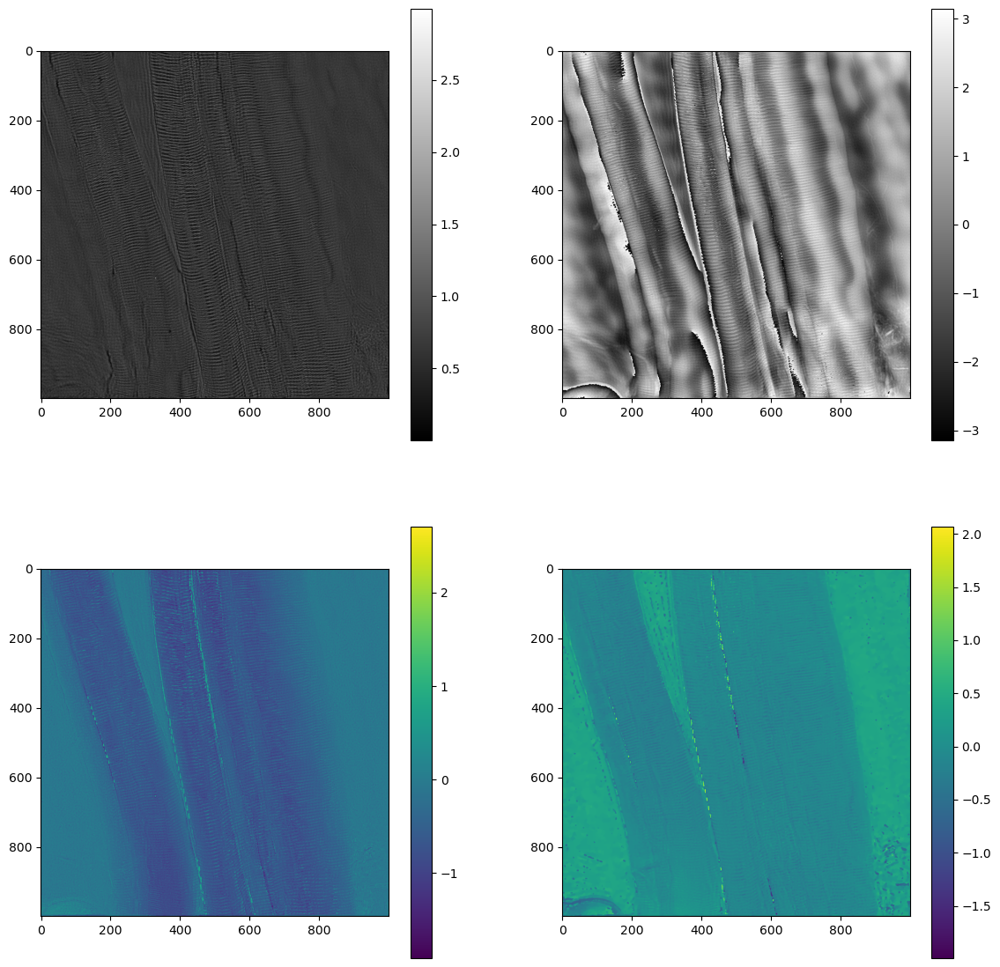

799


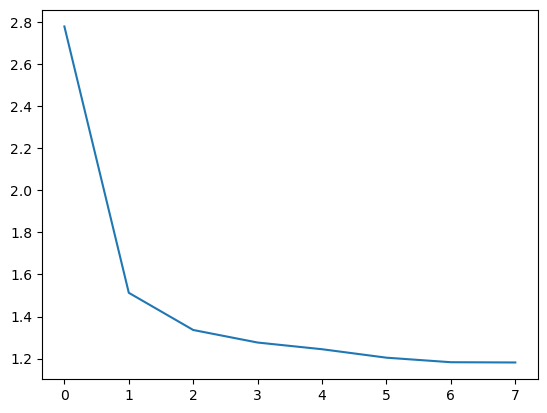

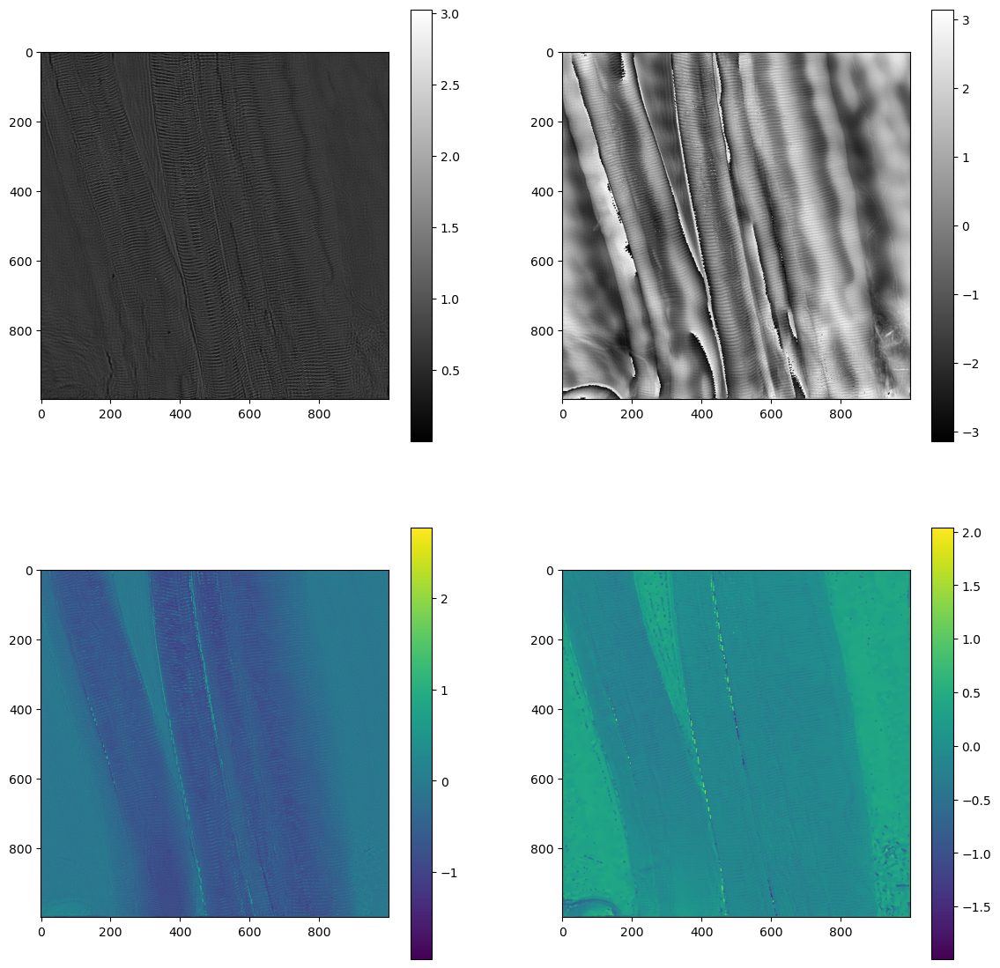

899


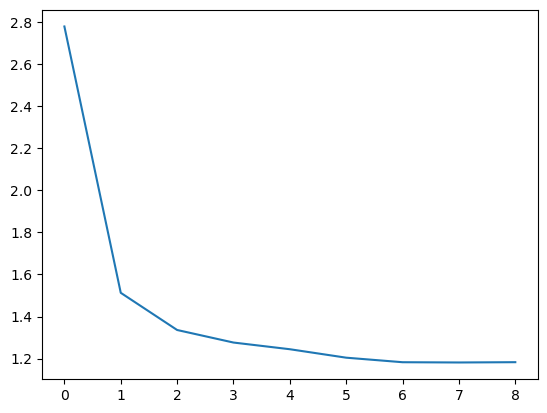

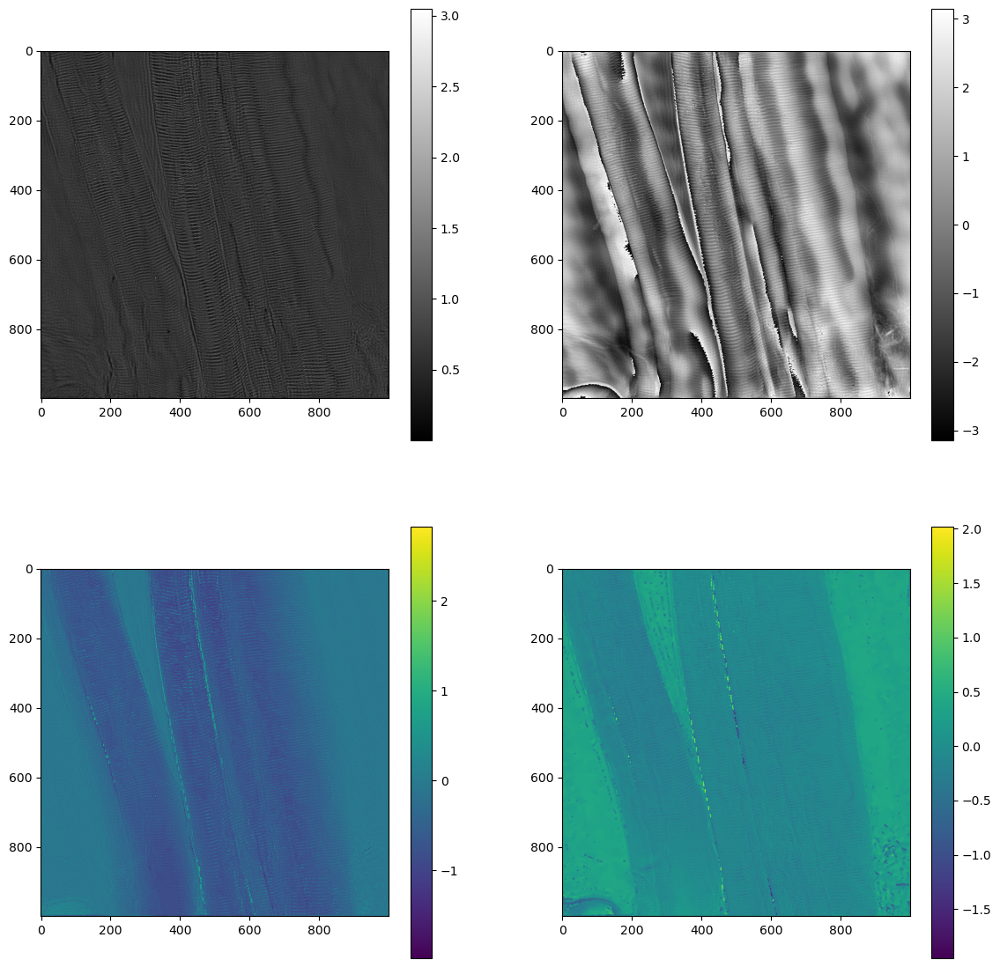

999


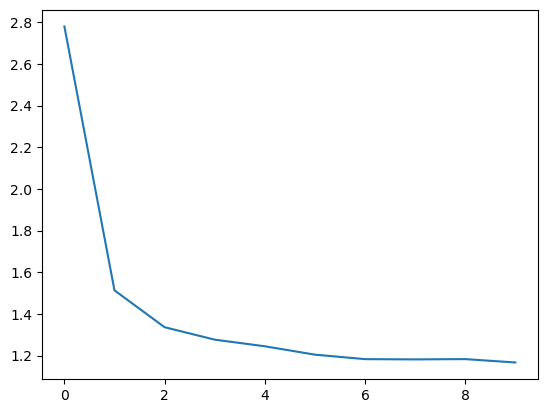

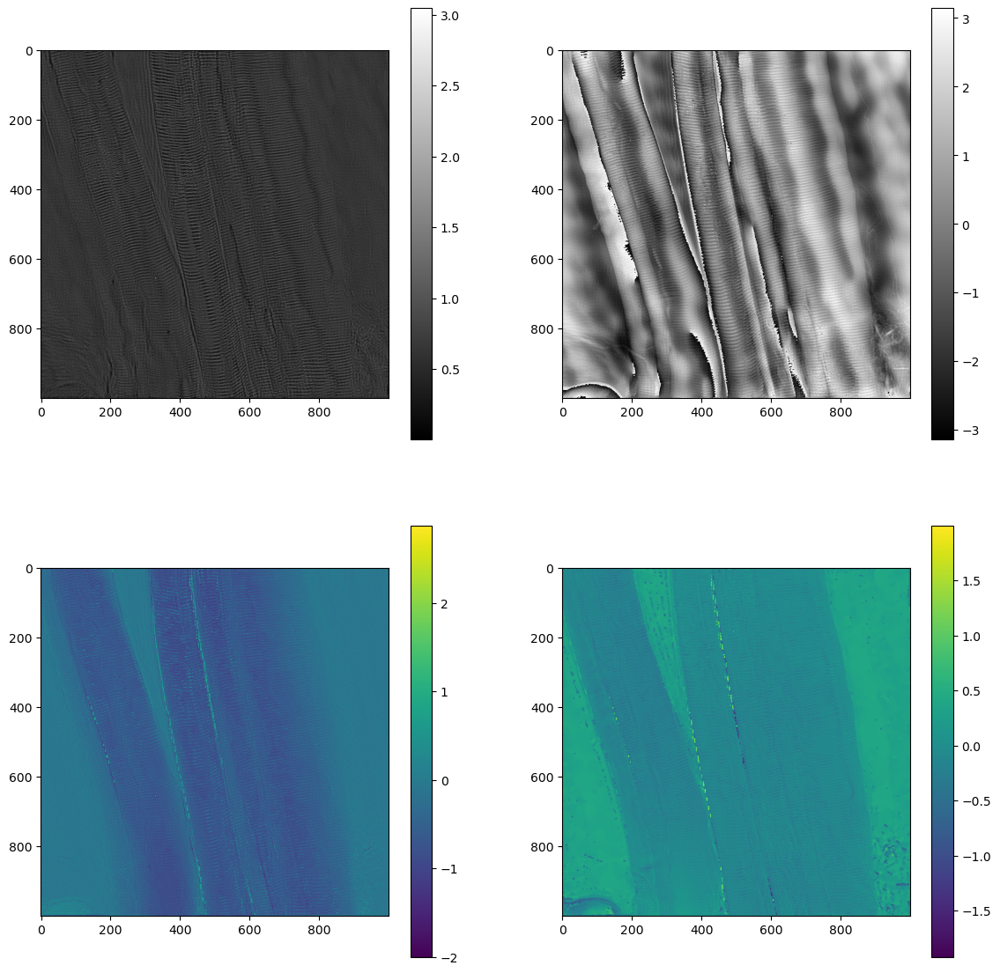

1099


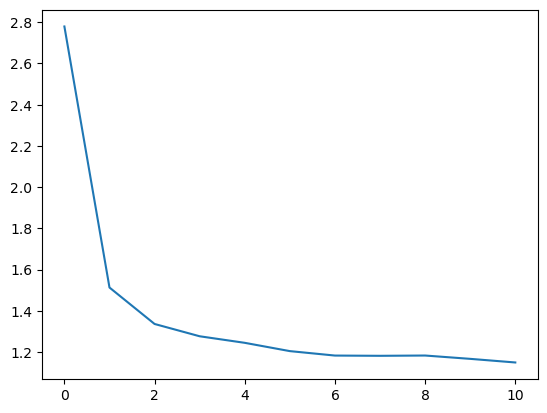

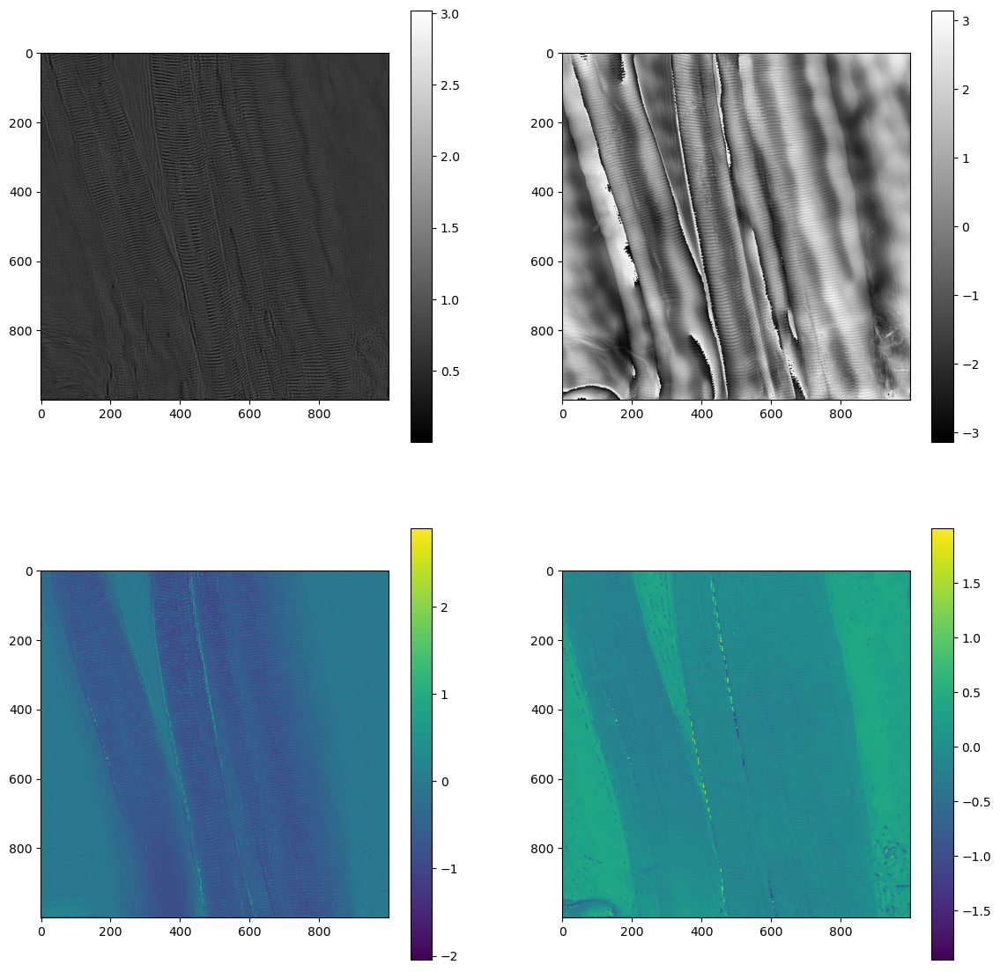

1199


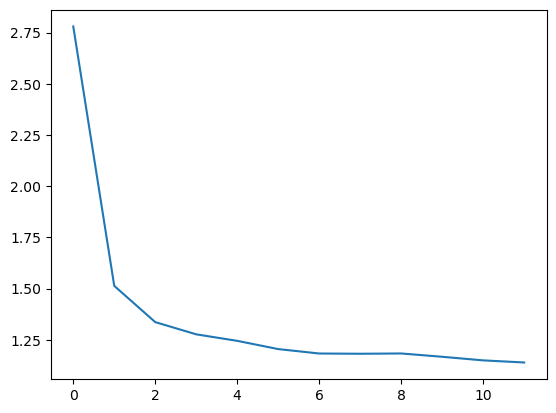

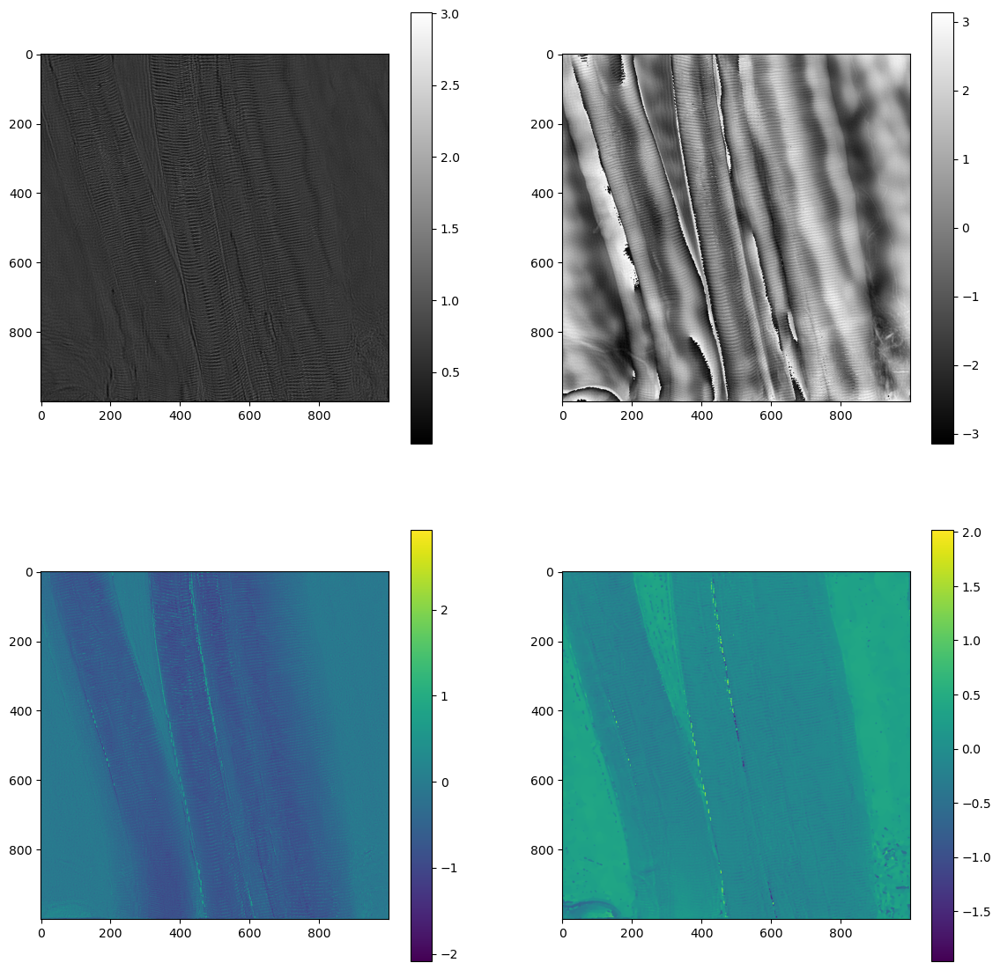

1299


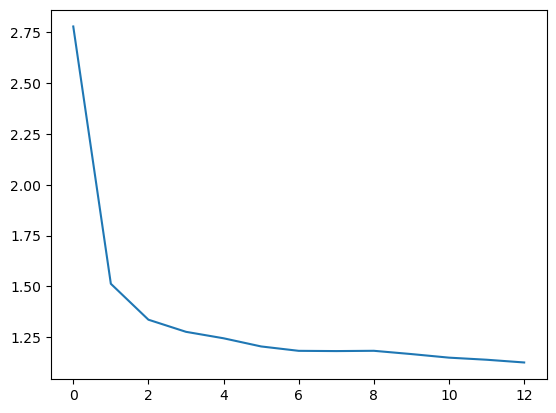

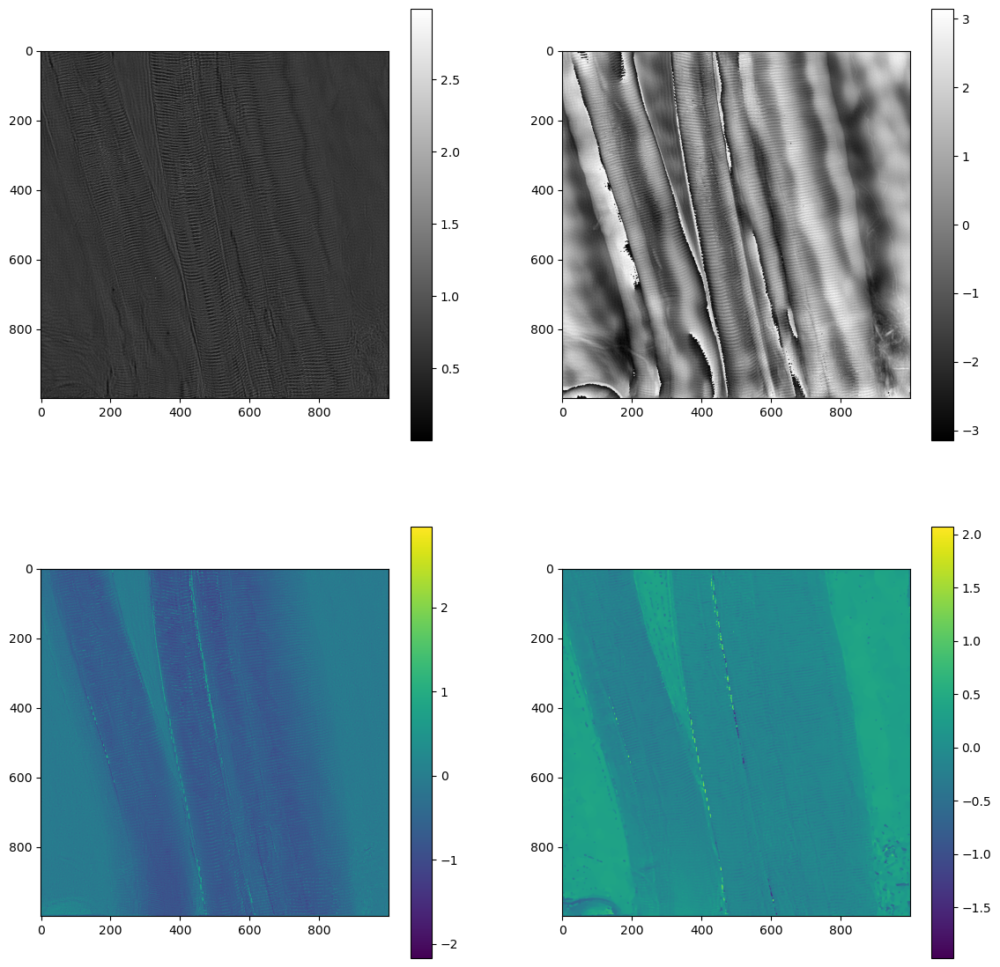

1399


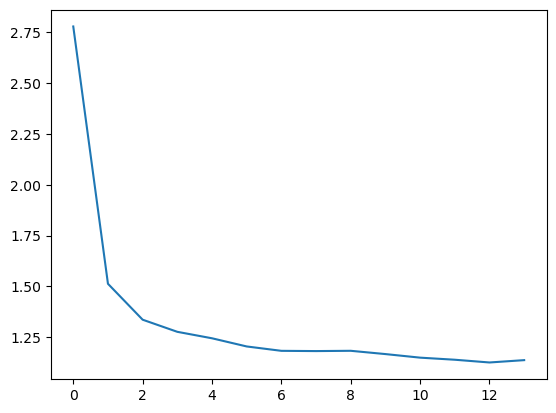

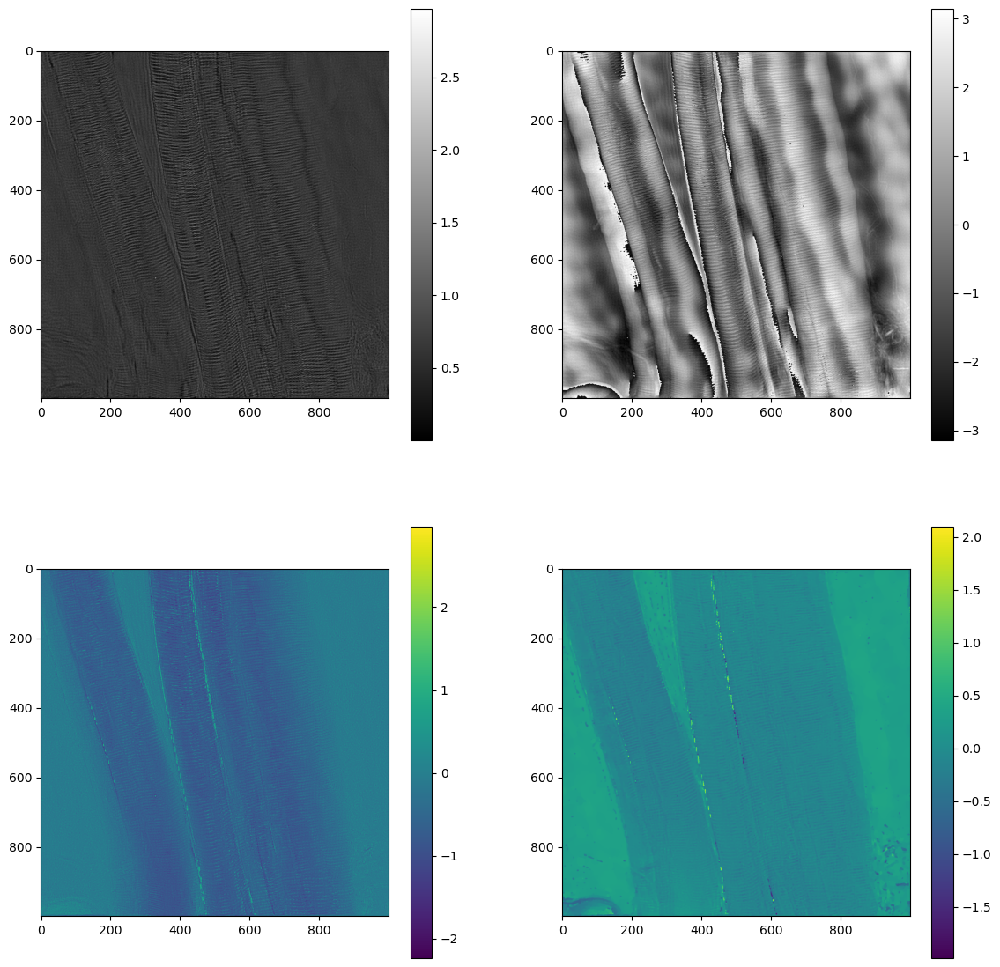

1499


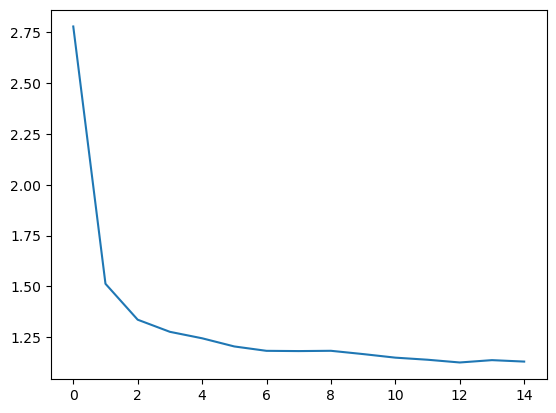

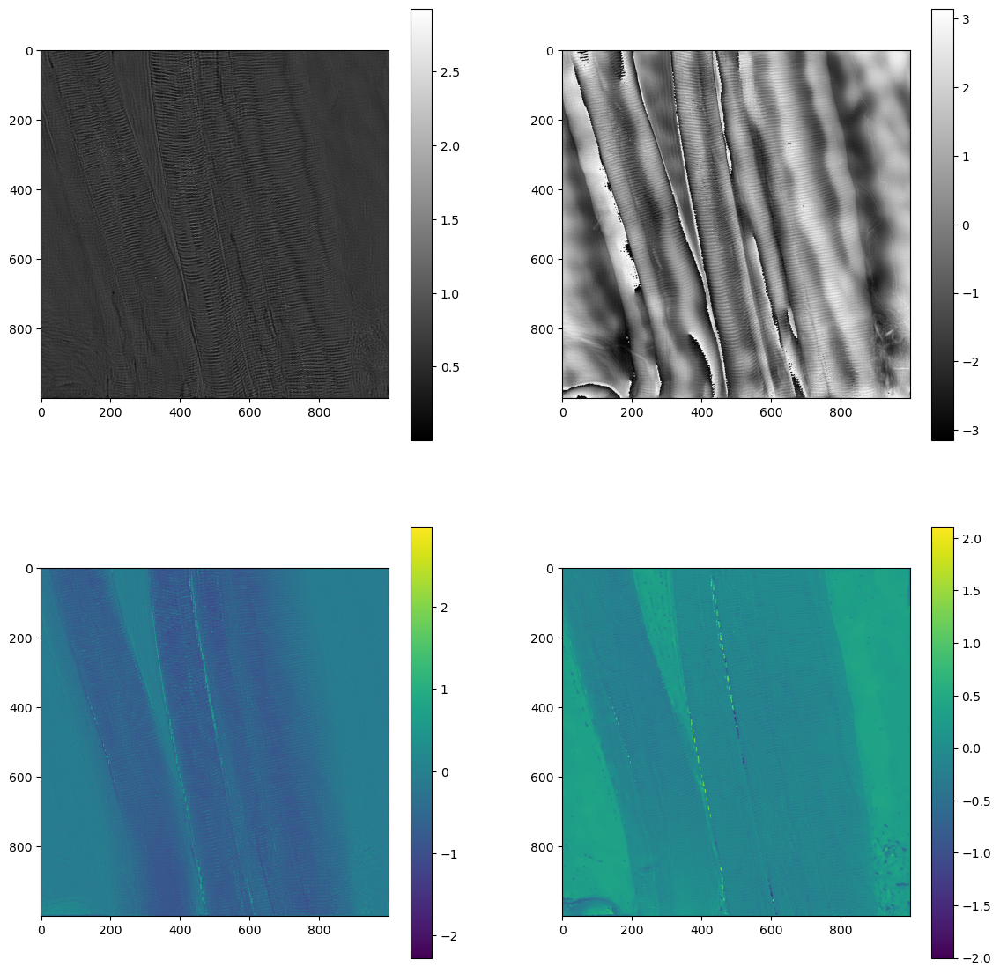

1599


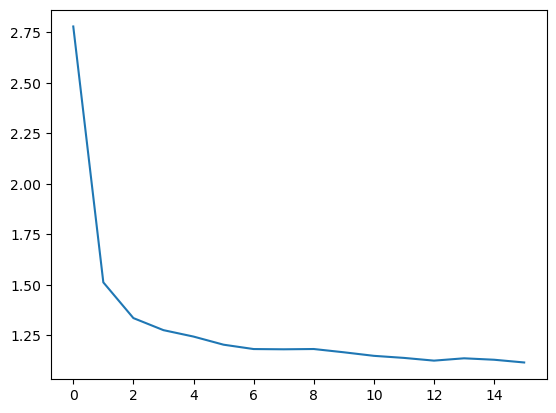

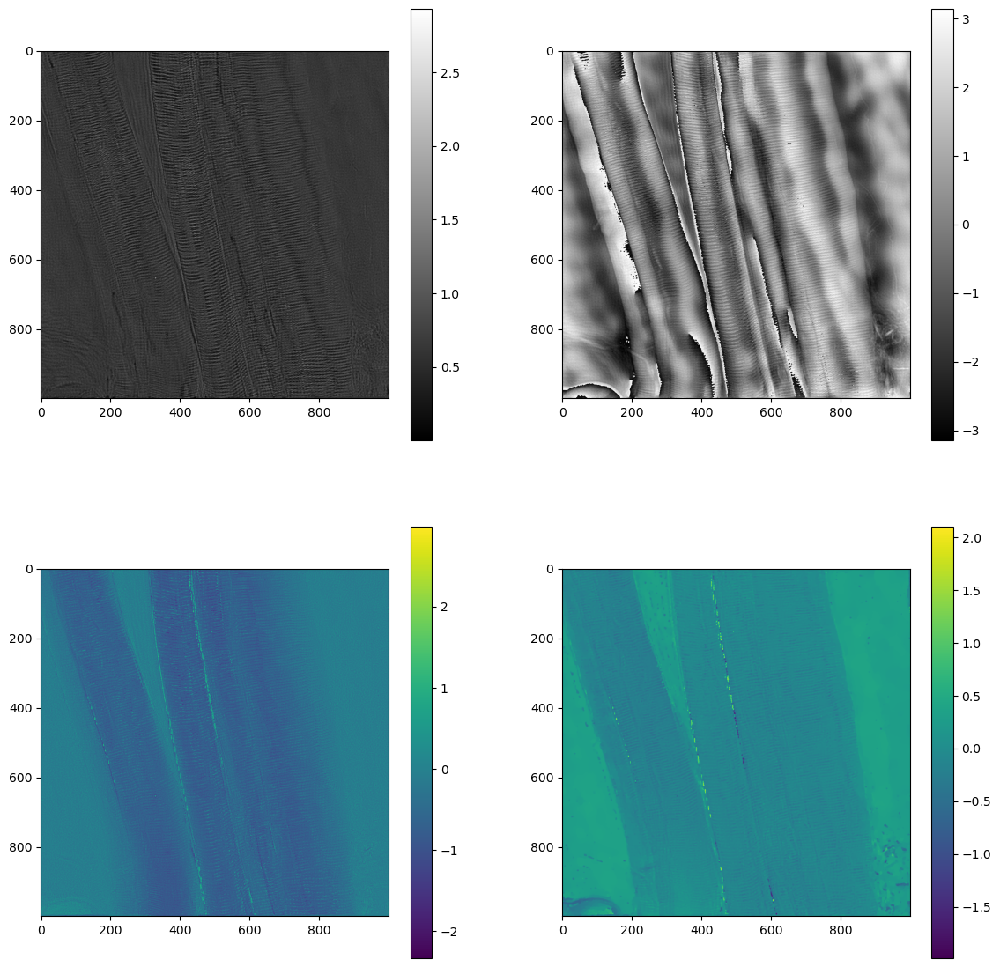

1699


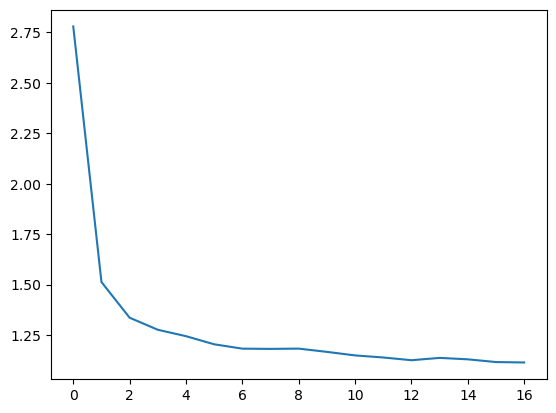

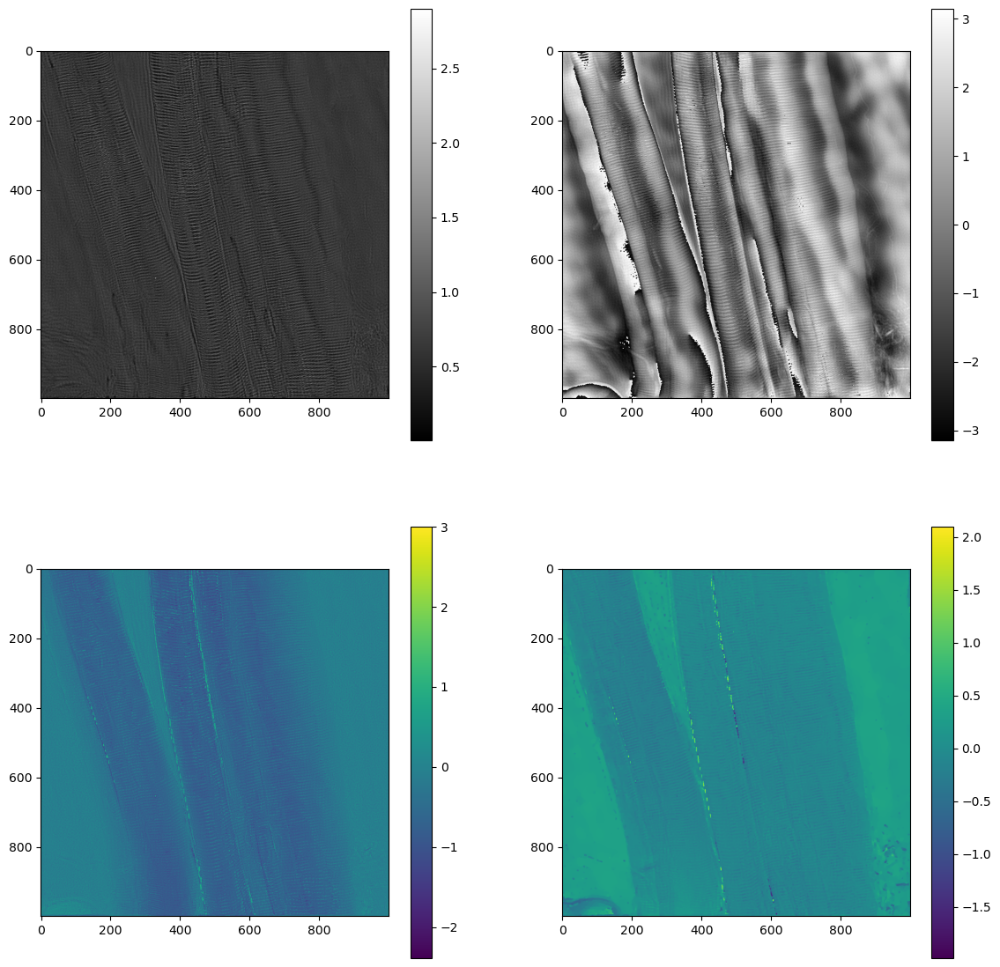

1799


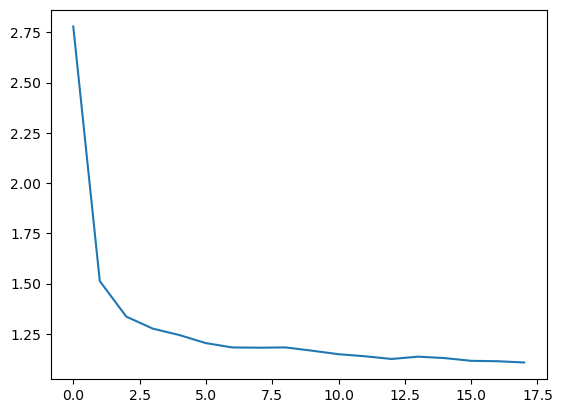

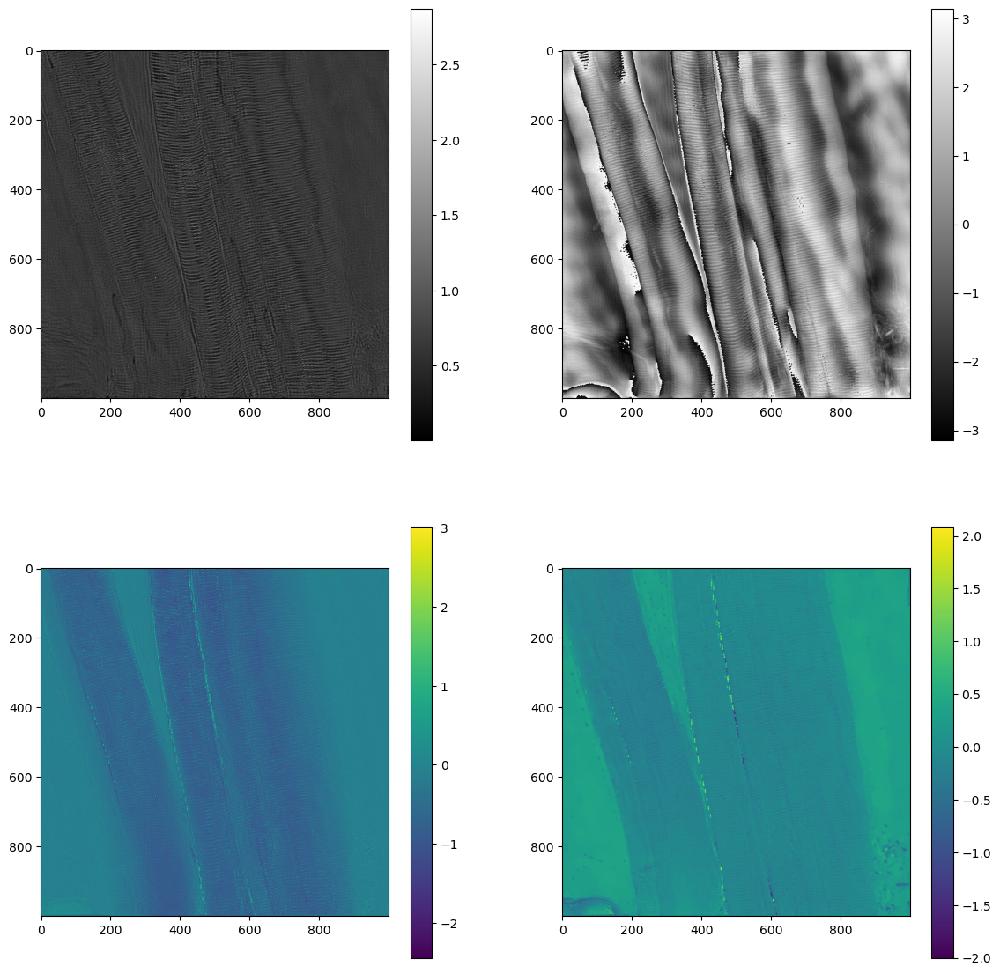

1899


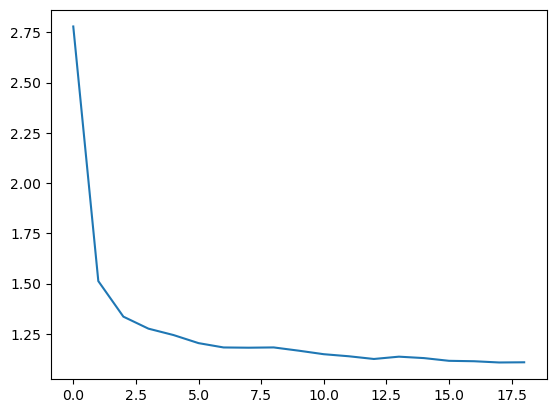

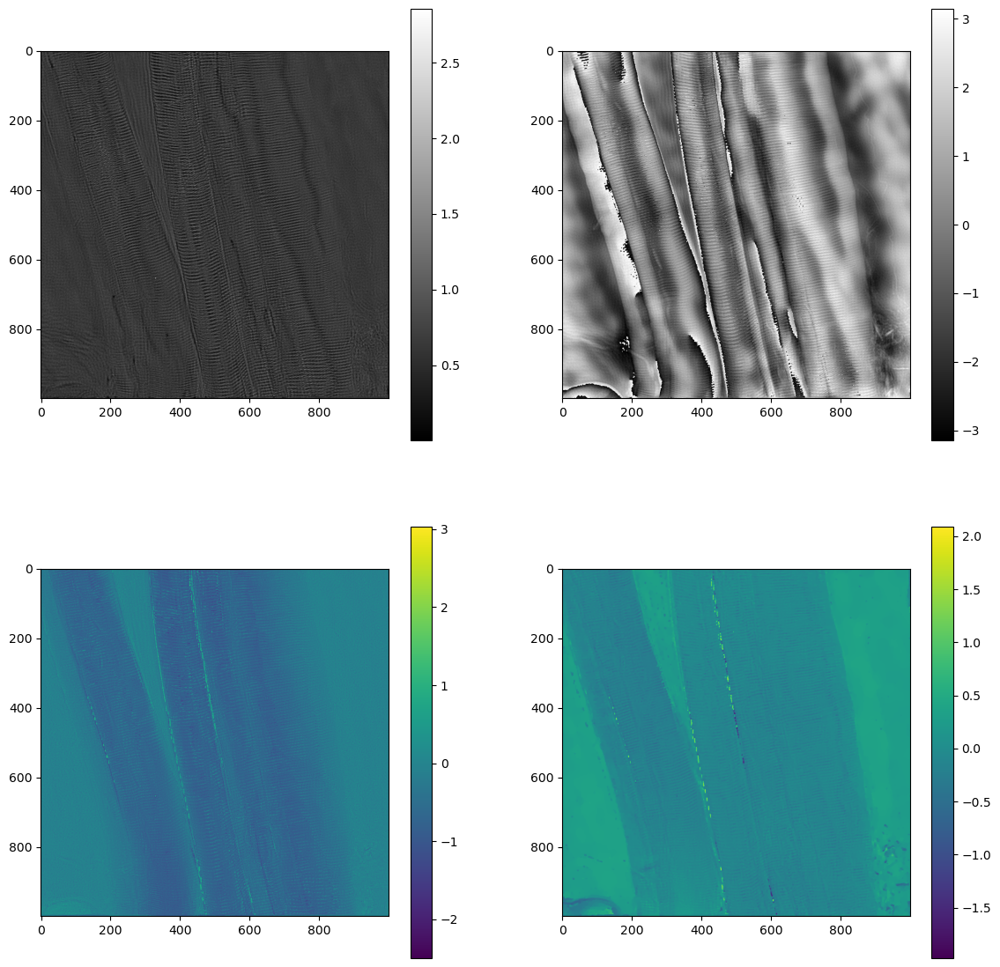

1999


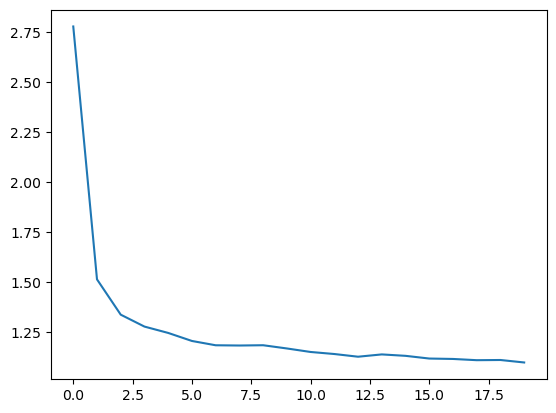

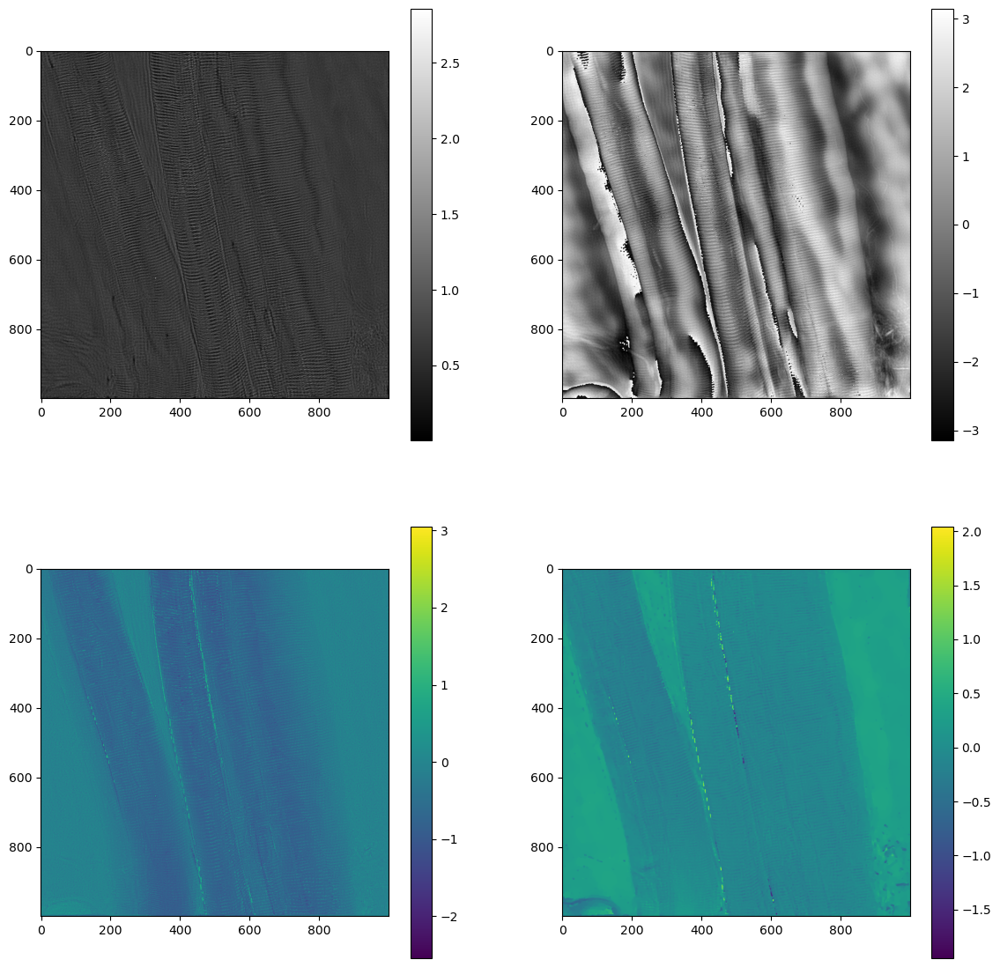

In [34]:
loss_seg = []
while i_iter < niter:
    idx_led = rng.choice(nled, batch_led, replace=False)
    # a_pred = forward_vfp(m,kxy[idx_led],P)
    a_pred = forward_lcp(a, delta, ori, kxy[idx_led], P)
    loss = (
        mse_real(a_pred, a_meas[idx_led].to(device))
        + 1e-1 * tv2d_iso(a)
        + 1e-1 * tv2d_iso(ori)
        + 1e-3 * tv2d_iso(delta)
    )  ### what is tv2d_iso doing??
    # a_pred = forward_fp(m,kxy,P)
    # loss = mse_real(a_pred,a_meas.to(device))
    optmizer.zero_grad()
    loss.backward()
    optmizer.step()

    i_iter += 1
    loss_seg.append(loss.item())

    if (i_iter + 1) % 100 == 0:
        print(i_iter)
        # loss_tot.append(loss.item())
        loss_tot.append(np.array(loss_seg).mean())
        loss_seg = []
        # snr_tot.append(snr(f_recon,f.to(device)).item())
        # plt.subplot(1,2,1)
        plt.plot(loss_tot)
        plt.show()
        [anp, dnp, onp] = [
            foo.clone().detach().cpu().numpy() for foo in [a, delta, ori]
        ]
        plt.figure(figsize=(14, 14))
        plt.subplot(2, 2, 1)
        plt.imshow(np.absolute(anp), cmap="gray")
        plt.colorbar(orientation="vertical")
        plt.subplot(2, 2, 2)
        plt.imshow(np.angle(anp), cmap="gray")
        plt.colorbar(orientation="vertical")
        plt.subplot(2, 2, 3)
        plt.imshow(dnp)
        plt.colorbar(orientation="vertical")
        plt.subplot(2, 2, 4)
        plt.imshow(onp)
        plt.colorbar(orientation="vertical")
        plt.show()

    """
    if (i_iter+1)%100 == 0:
        for g in optmizer.param_groups:
            g['lr'] = g['lr']*0.7
            print('lr',g['lr'])
    """

# original

In [35]:
loss_seg = []
while i_iter < niter:
    idx_led = rng.choice(nled, batch_led, replace=False)
    # a_pred = forward_vfp(m,kxy[idx_led],P)
    a_pred = forward_lcp(a, delta, ori, kxy[idx_led], P)
    loss = (
        mse_real(a_pred, a_meas[idx_led].to(device))
        + 1e-1 * tv2d_iso(a)
        + 1e-1 * tv2d_iso(ori)
        + 1e-3 * tv2d_iso(delta)
    )  ### what is tv2d_iso doing??
    # a_pred = forward_fp(m,kxy,P)
    # loss = mse_real(a_pred,a_meas.to(device))
    optmizer.zero_grad()
    loss.backward()
    optmizer.step()

    i_iter += 1
    loss_seg.append(loss.item())

    if (i_iter + 1) % 100 == 0:
        print(i_iter)
        # loss_tot.append(loss.item())
        loss_tot.append(np.array(loss_seg).mean())
        loss_seg = []
        # snr_tot.append(snr(f_recon,f.to(device)).item())
        # plt.subplot(1,2,1)
        plt.plot(loss_tot)
        plt.show()
        [anp, dnp, onp] = [
            foo.clone().detach().cpu().numpy() for foo in [a, delta, ori]
        ]
        plt.figure(figsize=(14, 14))
        plt.subplot(2, 2, 1)
        plt.imshow(np.absolute(anp), cmap="gray")
        plt.subplot(2, 2, 2)
        plt.imshow(np.angle(anp), cmap="gray")
        plt.subplot(2, 2, 3)
        plt.imshow(dnp)
        plt.subplot(2, 2, 4)
        plt.imshow(onp)
        plt.show()

    """
    if (i_iter+1)%100 == 0:
        for g in optmizer.param_groups:
            g['lr'] = g['lr']*0.7
            print('lr',g['lr'])
    """

In [36]:
[anp, dnp, onp] = [foo.clone().detach().cpu().numpy() for foo in [a, delta, ori]]
sio.savemat("results.mat", {"a": anp, "delta": dnp, "ori": onp})

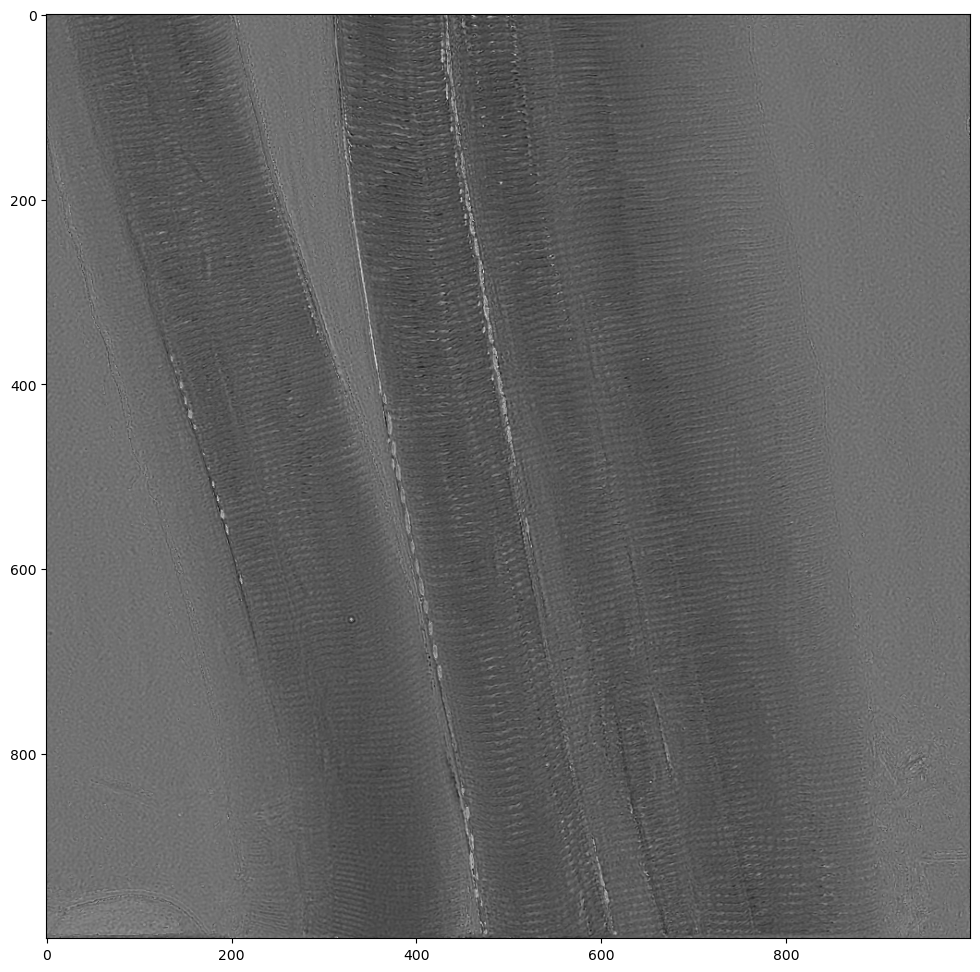

In [37]:
plt.figure(figsize=(12, 12))
plt.imshow(dnp, cmap="gray")